In [1]:
import pandas as pd
import requests
import json
import matplotlib.pyplot as plt
import numpy as np
from datetime import date

from noaa_sdk import NOAA

# Import plotting tools
import plotly.graph_objects as go
import chart_studio.plotly

# Machine Learning
from fbprophet import Prophet
from sklearn.model_selection import TimeSeriesSplit

from pprint import pprint

In C:\Users\bradp\anaconda3\envs\Capstone3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\bradp\anaconda3\envs\Capstone3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\bradp\anaconda3\envs\Capstone3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In C:\Users\bradp\anaconda3\envs\Capstone3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\bradp\anaconda3\envs

In [2]:
import os
os.chdir('C:\\Users\\bradp\\OneDrive\\Documents\\Springboard\\Capstone 3')

## EIA Generation Data by Source

In [3]:
# Energy Generation Data
# Carolinas: http://api.eia.gov/series/?api_key=YOUR_API_KEY_HERE&series_id=EBA.CAR-ALL.NG.COL.H
# Midwest: http://api.eia.gov/series/?api_key=YOUR_API_KEY_HERE&series_id=EBA.MIDW-ALL.NG.HL

eia_key = '28a55d57cbafe259bc2b894a861822ea'
base_url = 'http://api.eia.gov/series'

# Generation Sources
Carolinas_Gen = ['EBA.CAR-ALL.NG.COL.H', 'EBA.CAR-ALL.NG.WAT.H', 'EBA.CAR-ALL.NG.NG.H', 'EBA.CAR-ALL.NG.NUC.H', 'EBA.CAR-ALL.NG.OTH.H', 'EBA.CAR-ALL.NG.OIL.H', 'EBA.CAR-ALL.NG.SUN.H']
Midwest_Gen = ['EBA.MIDW-ALL.NG.COL.H', 'EBA.MIDW-ALL.NG.WAT.H', 'EBA.MIDW-ALL.NG.NG.H', 'EBA.MIDW-ALL.NG.NUC.H', 'EBA.MIDW-ALL.NG.OTH.H', 'EBA.MIDW-ALL.NG.OIL.H', 'EBA.MIDW-ALL.NG.SUN.H']

# Net Generation
Carolinas_Net_Gen = ['EBA.CAR-ALL.NG.HL']
Midwest_Net_Gen = ['EBA.MIDW-ALL.NG.HL']

Labels = ['Coal', 'Hydro', 'Natural Gas', 'Nuclear', 'Other','Petroleum','Solar']

SERIES_ID = Carolinas_Gen
SERIES_NAME = Labels

#Initialize a list of dataframes (one for each generation source)
df_list_gen = []

In [4]:
# Convert each series' API data to a DataFrame and append DataFrames to list

for i in range(len(SERIES_ID)):
    url = base_url + '/?api_key=' + eia_key + '&series_id=' + SERIES_ID[i]
    r = requests.get(url)
    json_data = r.json()
    
    df = pd.DataFrame(json_data.get('series')[0].get('data'), columns = ['Date', SERIES_NAME[i]])
    df.set_index('Date', drop=True, inplace=True)
    df_list_gen.append(df)

In [5]:
# Convert list of dataframes to single dataframe
gen = pd.concat(df_list_gen, axis=1)

# Create date as datetype datatype
gen['Year'] = gen.index.astype(str).str[:4]
gen['Month'] = gen.index.astype(str).str[4:6]
gen['Day'] = gen.index.astype(str).str[6:8]
gen['Hour'] = gen.index.astype(str).str[9:11]
gen['Date'] = pd.to_datetime(gen[['Year','Month','Day','Hour']])

gen.set_index('Date',drop=True,inplace=True)
final_gen = gen.iloc[:,:7]

## Plotly Interactive Time Series for Generation by Source

In [6]:
fig = go.Figure()

# Add traces
for i in range(len(final_gen.columns)):
    fig.add_trace(go.Scatter(x=final_gen.index, y=final_gen.iloc[:,i],
                    mode='lines',
                    name=final_gen.columns[i],
                    line_width=1))
fig.show()

## EIA Day-Ahead Forecast Data

In [7]:
# Day-Ahead Demand Forecast Data

# Carolinas: http://api.eia.gov/category/?api_key=YOUR_API_KEY_HERE&category_id=3389853
# Midwest: http://api.eia.gov/series/?api_key=YOUR_API_KEY_HERE&series_id=EBA.MIDW-ALL.DF.HL

base_url = 'http://api.eia.gov/series/'
Carolinas_Demand = ['EBA.CAR-ALL.DF.HL']
Midwest_Demand = ['EBA.MIDW-ALL.DF.HL']

SERIES_ID = Carolinas_Demand

url = base_url + '/?api_key=' + eia_key + '&series_id=' + SERIES_ID[0]
r = requests.get(url)
json_data = r.json()
    
demand = pd.DataFrame(json_data.get('series')[0].get('data'), columns = ['Date', 'Day-Ahead Forecast (MW)'])
demand.set_index('Date', drop=True, inplace=True)

# Create date as datetype datatype
demand['Year'] = demand.index.astype(str).str[:4]
demand['Month'] = demand.index.astype(str).str[4:6]
demand['Day'] = demand.index.astype(str).str[6:8]
demand['Hour'] = demand.index.astype(str).str[9:11]
demand['Date'] = pd.to_datetime(demand[['Year','Month','Day','Hour']])

demand.set_index('Date',drop=True,inplace=True)
final_demand = demand.iloc[:,:1]

In [8]:
final_demand.head()

,Day-Ahead Forecast (MW)
Date,
2021-02-18 00:00:00,16897
2021-02-17 23:00:00,17705
2021-02-17 22:00:00,18615
2021-02-17 21:00:00,19258
2021-02-17 20:00:00,19424


In [9]:
# Add total generation
final_gen['Total_Renewables'] = final_gen.iloc[:,[1,3,6]].sum(axis=1)
final_gen['Total_Generation (MW)'] = final_gen.iloc[:,:7].sum(axis=1)
final_gen.head()

,Coal,Hydro,Natural Gas,Nuclear,Other,Petroleum,Solar,Total_Renewables,Total_Generation (MW)
Date,,,,,,,,,
2021-02-17 05:00:00,8236,524,6291,12045,1137,0,-1,12568,28232
2021-02-17 04:00:00,8227,1026,6310,12048,1157,0,-2,13072,28766
2021-02-17 03:00:00,8205,1380,6453,12041,1177,0,-1,13420,29255
2021-02-17 02:00:00,8072,1562,6379,12034,1171,0,-3,13593,29215
2021-02-17 01:00:00,7994,1746,6392,11990,1149,0,29,13765,29300


## Compare Day-Ahead Forecast to Actual Electric Generation

"Each day, balancing authorities forecast hourly electricity demand on their systems for the next day. The forecast reflects daily, weekly, and seasonal demand patterns plus expected weather conditions."
https://www.eia.gov/beta/electricity/gridmonitor/about

In [10]:
# Merge generation data with demand data

# shift day-ahead forecast forward one-day to compare to the observed amount
demand_shifted = final_demand.shift(-5)

# merge on index data
df_all = final_gen.merge(demand_shifted, left_index=True, right_index=True, how='inner')

# add column describing difference between day-ahead forecast and actual
df_all['Excess Forecasted (MW)'] = df_all['Day-Ahead Forecast (MW)'] - df_all['Total_Generation (MW)']

forecast_errors = df_all.iloc[:,8:11]
forecast_errors.head()

,Total_Generation (MW),Day-Ahead Forecast (MW),Excess Forecasted (MW)
Date,,,
2018-07-01 05:00:00,26539,28353.0,1814.0
2018-07-01 06:00:00,24971,26132.0,1161.0
2018-07-01 07:00:00,23889,24225.0,336.0
2018-07-01 08:00:00,23048,23036.0,-12.0
2018-07-01 09:00:00,22493,22171.0,-322.0


In [11]:
# Plot forecast errors

fig = go.Figure()

# Add traces
for i in range(len(forecast_errors.columns)):
    fig.add_trace(go.Scatter(x=forecast_errors.index, y=forecast_errors.iloc[:,i],
                    mode='lines',
                    name=forecast_errors.columns[i],
                    line_width=1))
fig.show()

In [12]:
# Large Data Anomalies in the EIA Forecasted Demand Data:
forecast_errors[forecast_errors.iloc[:,2] > 9000]

,Total_Generation (MW),Day-Ahead Forecast (MW),Excess Forecasted (MW)
Date,,,
2019-01-13 23:00:00,27188,36814.0,9626.0
2019-03-09 20:00:00,22942,486241.0,463299.0
2019-03-09 21:00:00,22904,99923.0,77019.0
2019-03-20 00:00:00,23667,42892.0,19225.0
2019-03-21 04:00:00,22076,31410.0,9334.0
2019-03-28 01:00:00,23714,33133.0,9419.0
2019-04-05 05:00:00,17702,30421.0,12719.0
2019-04-13 19:00:00,21696,32455.0,10759.0


In [13]:
forecast_errors['2019-03-21 03:00:00':'2019-03-21 06:00:00']

,Total_Generation (MW),Day-Ahead Forecast (MW),Excess Forecasted (MW)
Date,,,
2019-03-21 03:00:00,23142,25451.0,2309.0
2019-03-21 04:00:00,22076,31410.0,9334.0
2019-03-21 05:00:00,21659,22944.0,1285.0
2019-03-21 06:00:00,21350,22147.0,797.0


# Facebook Prophet

In [14]:
# Create dataframe in format required by Facebook Prophet
df = final_gen.iloc[:,[8]]
df.reset_index(inplace=True)
df.columns = ['ds','y']
df.head()

,ds,y
0,2021-02-17 05:00:00,28232
1,2021-02-17 04:00:00,28766
2,2021-02-17 03:00:00,29255
3,2021-02-17 02:00:00,29215
4,2021-02-17 01:00:00,29300


In [15]:
# Fit model
m = Prophet()
m.fit(df)

In [16]:
# Create datetimes for longterm prediction
future = m.make_future_dataframe(periods=365)
future.tail()

,ds
23449,2022-02-13 05:00:00
23450,2022-02-14 05:00:00
23451,2022-02-15 05:00:00
23452,2022-02-16 05:00:00
23453,2022-02-17 05:00:00


In [17]:
forecast = m.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
23449,2022-02-13 05:00:00,28806.622318,13096.626534,43959.506001
23450,2022-02-14 05:00:00,29790.193873,14600.470633,44755.537653
23451,2022-02-15 05:00:00,30882.154417,15640.120808,45913.890572
23452,2022-02-16 05:00:00,31021.573689,15769.325034,45903.610470
23453,2022-02-17 05:00:00,31357.354471,15679.947445,46257.366401


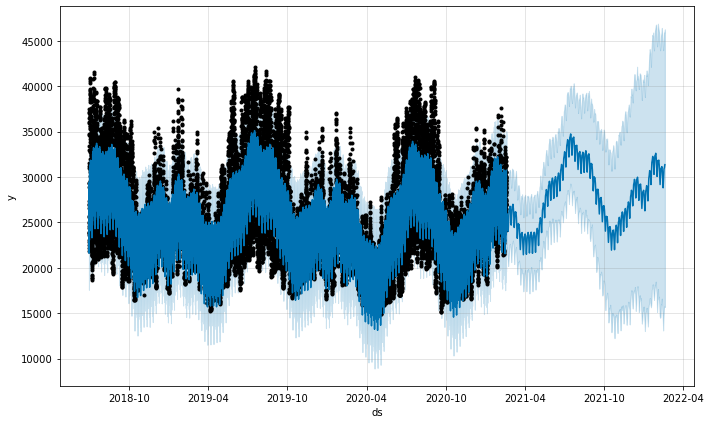

In [18]:
fig1=m.plot(forecast)

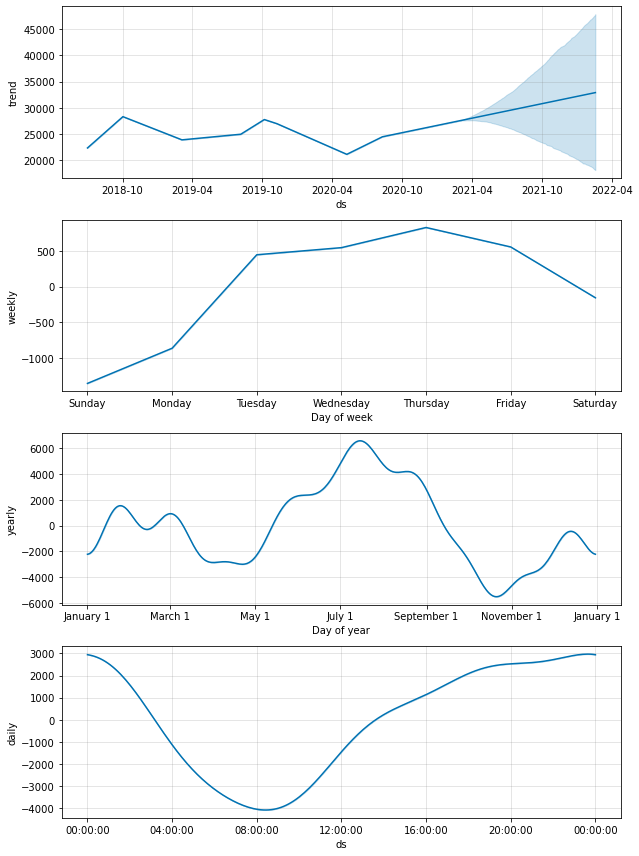

In [19]:
fig2 = m.plot_components(forecast)

In [66]:
# The below code is for interactive versions of the above graphs, but they run slowly.

#from fbprophet.plot import plot_plotly, plot_components_plotly
#plot_plotly(m, forecast)

#plot_components_plotly(m, forecast)

## Prophet Cross Validation

In [63]:
tscv = TimeSeriesSplit(n_splits=5)

In [61]:
# Train-Test Split
X = df.index
y = df.iloc[:,0]

for train_index, test_index in tscv.split(X):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

In [65]:
from fbprophet.diagnostics import cross_validation
df_cv = cross_validation(m, horizon = '48 hours')

INFO:fbprophet:Making 595 forecasts with cutoffs between 2019-07-02 05:00:00 and 2021-02-15 05:00:00


In [67]:
print(df_cv.shape)
df_cv.head()

(28560, 6)


,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,2019-07-02 06:00:00,28007.229463,23935.755188,31933.476719,25191,2019-07-02 05:00:00
1,2019-07-02 07:00:00,27447.687380,23836.973639,31657.144918,24260,2019-07-02 05:00:00
2,2019-07-02 08:00:00,27166.067793,23206.967776,31166.673858,23654,2019-07-02 05:00:00
3,2019-07-02 09:00:00,27268.636724,23561.201025,31318.513684,22875,2019-07-02 05:00:00
4,2019-07-02 10:00:00,27857.157455,23896.878680,31739.559356,23071,2019-07-02 05:00:00


In [68]:
from fbprophet.diagnostics import performance_metrics
df_p = performance_metrics(df_cv)
df_p.head()

,horizon,mse,rmse,mae,mape,mdape,coverage
0,0 days 05:00:00,9.764311e+06,3124.789675,2409.404835,0.108914,0.094857,0.823950
1,0 days 06:00:00,1.096221e+07,3310.922143,2574.475424,0.115159,0.102687,0.799650
2,0 days 07:00:00,1.242138e+07,3524.397128,2758.444591,0.120494,0.108992,0.768277
3,0 days 08:00:00,1.345232e+07,3667.740394,2883.789859,0.122077,0.110506,0.749440
4,0 days 09:00:00,1.350093e+07,3674.361626,2883.524511,0.118296,0.106485,0.747899


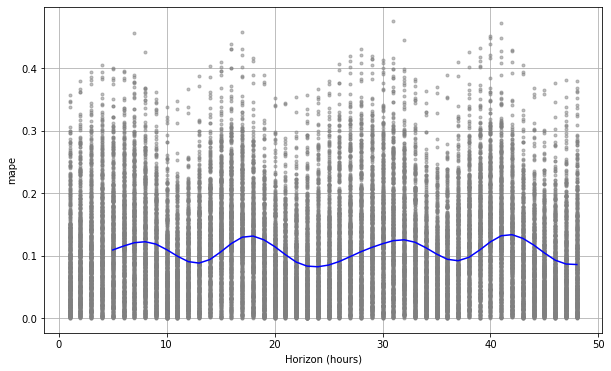

In [69]:
# Visualization
from fbprophet.plot import plot_cross_validation_metric
fig = plot_cross_validation_metric(df_cv, metric='mape')

In [70]:
pip freeze > requirements.txt

Note: you may need to restart the kernel to use updated packages.
